In [1]:
using Distributions
using AlphaStableDistributions
using Statistics
using Plots
using StatsPlots
using StatsFuns
using Measures
using PyCall
using ColorTypes
using NamedArrays

import ColorSchemes.viridis

In [2]:
parent_folder = dirname(dirname(pwd()))
source_path = parent_folder * "\\src\\julia"

include("$source_path/01_priors.jl")
include("$source_path/02_diffusion.jl")
include("$source_path/03_experiment.jl")
include("$source_path/04_datasets.jl");

# Alpha stable distribution

In [8]:
normal_data = rand(Normal(0,1), 1000000);
alpha_fit = fit(AlphaStable, normal_data)

AlphaStable{Float64}(α=1.9955903335911027, β=-0.01820669505210543, scale=0.7072083230224893, location=0.0004502257798173993)

In [9]:
alpha_data = rand(AlphaStable(α=2.0, β=0.0, scale=1.0, location=0.0), 1000000);
normal_fit = fit(Normal, alpha_data)

Normal{Float64}(μ=0.00131231385370189, σ=1.4151588967381394)

In [10]:
alpha_data = rand(AlphaStable(α=2.0, β=0.0, scale=1.0/sqrt(2), location=0.0), 1000000);
normal_fit = fit(Normal, alpha_data)

Normal{Float64}(μ=-9.326515094739276e-5, σ=0.9995355619903517)

In [11]:
alpha_data = rand(AlphaStable(α=1.0, β=0.0, scale=1.0/sqrt(2), location=0.0), 1000000);
cauchy_fit = fit(Cauchy, alpha_data)

Cauchy{Float64}(μ=-0.0010301595536278466, σ=0.7088192245747269)

In [12]:
alpha_data = rand(AlphaStable(α=1.0, β=0.0, scale=1.0, location=0.0), 1000000);
cauchy_fit = fit(Cauchy, alpha_data)

Cauchy{Float64}(μ=-0.0015075245829873313, σ=1.00176687242115)

# Prior predictive & pushforward checks

Parameters

•	a = threshold separation; 

•	zr = relative starting point;

•	v0 = drift rate for blue stimuli or non-word stimuli;

•	v1 = drift rate for orange stimuli or word stimuli; 

•	t0 = non-decisional time; 

•	alpha = stability parameter of noise distribution; 

•	sz = across-trial variability in starting point; 

•	sv = across-trial variability in drift rate;

•	st = across-trial variability in non-decisional processes 



In [3]:
# General settings
n_models = 4
n_clusters = 40
n_trials = 900
lower_bound = 0.1
upper_bound = 10.0;

## Hyperpriors

2418 2582
2502 2498


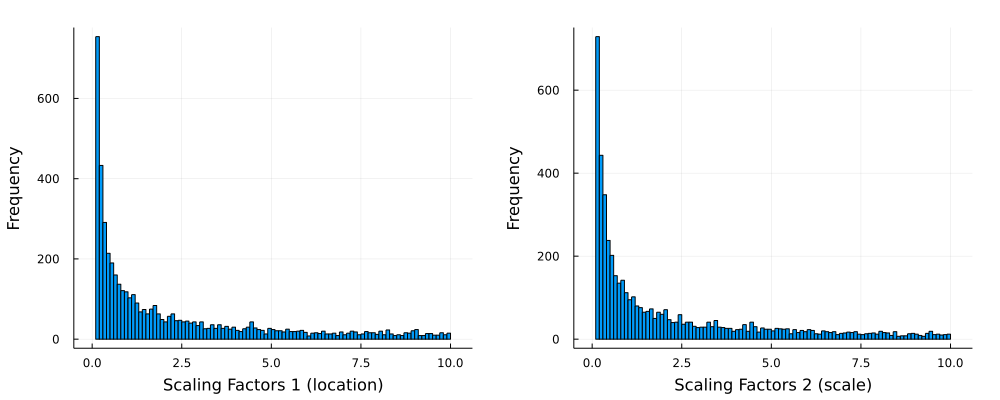

In [4]:
# Check power scaling factors - should be uniformly distributed below and above 1
num_iterations = 5000
scaling_factors_1 = Float64[]
scaling_factors_2 = Float64[]

for _ in 1:num_iterations
    factors = generate_scaling_factors(lower_bound, upper_bound)
    push!(scaling_factors_1, factors[1])
    push!(scaling_factors_2, factors[2])
end

println(sum(scaling_factors_1 .< 1), " ", sum(scaling_factors_1 .> 1))
println(sum(scaling_factors_2 .< 1), " ", sum(scaling_factors_2 .> 1))

plot(
    histogram(scaling_factors_1, bins=100, xlabel="Scaling Factors 1 (location)", ylabel="Frequency", legend=false),
    histogram(scaling_factors_2, bins=100, xlabel="Scaling Factors 2 (scale)", ylabel="Frequency", legend=false),
    layout=(1, 2),
    size=(1000, 400),
    margin=5mm
)


In [5]:
# Unique settings
scaling_factors = [[lower_bound, lower_bound], [1.0, 1.0], [upper_bound, upper_bound]]
n_scaling_factors = length(scaling_factors)
n_sims_hyperpriors = 10000
n_params = 2;

In [6]:
# Simulate
hyperprior_sims = fill(0.0, (n_scaling_factors, n_sims_hyperpriors, n_params))

for scaling_index in 1:n_scaling_factors
    for i in 1:n_sims_hyperpriors
        hyperprior_sims[scaling_index, i, :] = generate_levy_hyperpriors(scaling_factors[scaling_index])[end-1:end]
    end
end

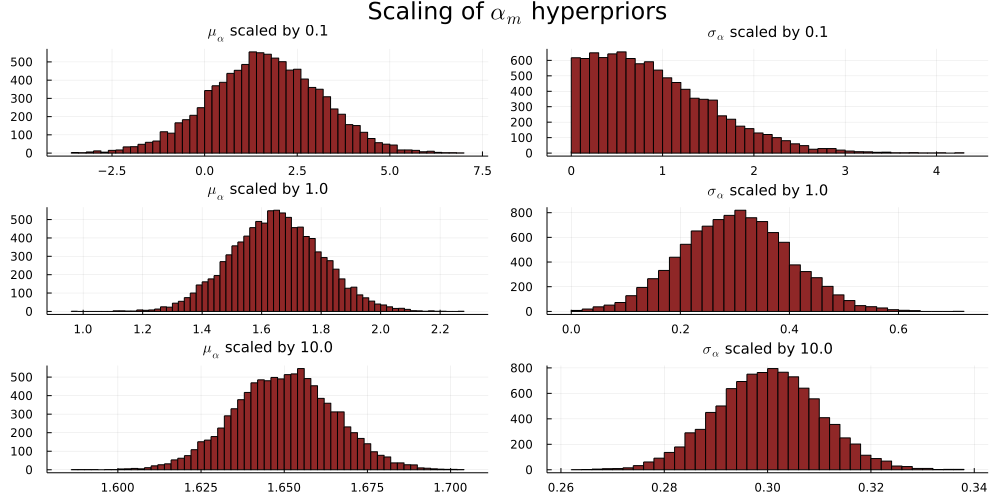

In [7]:
# Plot
hyperprior_labels = ["\$\\mu_\\alpha\$" "\$\\sigma_\\alpha\$"]

# Create an array of plots, one per scaling factor
all_plots = []
for i in 1:length(scaling_factors)
    p = plot(layout=2, titlefont=10, size=(1000, 500))
    push!(all_plots, p)
    plot_title = hyperprior_labels .* " scaled by " .* ["$(scaling_factors[i][1])" "$(scaling_factors[i][2])"]
    histogram!(hyperprior_sims[i, :, :], title=plot_title, legend=false, color="#8f2727")
end

# Combine the plots into a grid layout
combined_plot = plot(all_plots..., layout=(3, 1), legend=false, plot_title="Scaling of \$\\alpha_m\$ hyperpriors")
display(combined_plot)

## Group-level priors

In [8]:
# Unique settings
n_sims_grouppriors = 500
n_sims_persons = 40
scaling_factors = [
    [lower_bound, upper_bound],
    [1.0, upper_bound],
    [upper_bound, upper_bound],
    [lower_bound, 1.0],   
    [1.0, 1.0],
    [upper_bound, 1.0], 
    [lower_bound, lower_bound],
    [1.0, lower_bound],
    [upper_bound, lower_bound]
]
n_scaling_factors = length(scaling_factors);

In [9]:
# Simulate
prior_sims_persons = fill(0.0, (n_scaling_factors, n_sims_grouppriors, n_sims_persons))

for scaling_index in 1:n_scaling_factors
    for i in 1:n_sims_grouppriors
        hyperpriors = generate_levy_hyperpriors(scaling_factors[scaling_index])
        for m in 1:n_sims_persons
            prior_sims_persons[scaling_index, i, m] = generate_levy_priors(hyperpriors...)[6]
        end
    end
end

marginals = reshape(prior_sims_persons, n_scaling_factors, n_sims_grouppriors * n_sims_persons);

In [10]:
# Save simulated data
using NPZ

"Helper function to save simulated datasets as npy files."
function save_to_npy(dataset::Array, name::String)
    target_folder = "../../data/levy_comparison"
    filename = "$name.npy"
    target_path = joinpath(target_folder, filename)

    npzwrite(target_path, dataset)
end;

save_to_npy(prior_sims_persons, "alpha_priors_under_scaling")

In [11]:
#gr(fontfamily="Palatino")

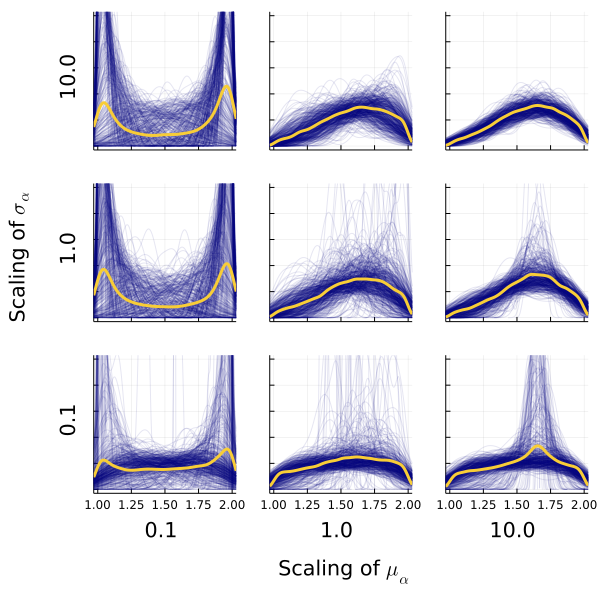

In [27]:
# Plot with zoomed in y axis
ylims = [0, 5]

# Create an array of plots, one per scaling factor
all_plots = []
for i in 1:length(scaling_factors)
    p = plot(size=(600, 600))
    push!(all_plots, p)
    for data_set in 1:n_sims_grouppriors
        data = vec(prior_sims_persons[i, data_set, :])
        density!(data, xlims=[1,2], color="#000080", alpha=0.1)
    end
    density!(marginals[i, :], xlims=[1,2], color="#f8cd37", linewidth=3)

    if i >= 7
        xlabel!(p, "$(scaling_factors[i][1]) \n \n ", xlabelfontsize=14)
        if i == 8
            xlabel!(p, "$(scaling_factors[i][1]) \n \n Scaling of \$\\mu_\\alpha\$", xlabelfontsize=14)
        end
    else
        xaxis!(p, xformatter=Returns(""))
    end
    
    yaxis!(p, yformatter=Returns(""))

    if i % 3 == 1
        ylabel!(p, "\n \n $(scaling_factors[i][2])", ylabelfontsize=14)
        if i == 4
            ylabel!(p, "Scaling of \$\\sigma_\\alpha\$ \n \n $(scaling_factors[i][2])", ylabelfontsize=14)
        end
    end
end

# Combine the plots into a grid layout
combined_plot = plot(all_plots..., layout=(3, 3), ylims=ylims, legend=false)#, plot_title="\$\\alpha_m\$ per data set under scaled hyperpriors")
display(combined_plot)

In [29]:
savefig("../../figures/alpha_priors_under_scaling.pdf")

## Pushforward: RTs

In [12]:
# Pickle loading functions
py"""
import pickle
 
def load_pickle(fpath):
    with open(fpath, "rb") as f:
        data = pickle.load(f)
    return data
"""
load_pickle = py"load_pickle"

# Load data
scaled_sim_dict = load_pickle("../../data/levy_comparison/sim_powerscaled/finetune.pkl")
unscaled_sim_dict = load_pickle("../../data/levy_comparison/sim_unscaled/finetune.pkl")
sim_dicts = [scaled_sim_dict, unscaled_sim_dict];

In [13]:
plot_labels = ["Basic Diffusion Model", "Basic Lévy Flight Model", "Full Diffusion Model", "Full Lévy Flight Model"]
scaling_settings = ["powerscaled", "unscaled"];

In [16]:
# Compare summary stats over all data sets
dataset_mean_per_model = fill(0.0, (2, 4, 2000))
for i in 1:2
    for model in 1:n_models
        dataset_mean_per_model[i, model, :] = mean(sim_dicts[i]["model_outputs"][model]["sim_data"][:, :, :, 2], dims=2:3)[:, 1, 1]
    end
end

# Mean and std of data set means
println(NamedArray(mean(dataset_mean_per_model, dims=3)[:,:,1], (["powerscaled", "unscaled"], plot_labels), ("mean","")))
println(NamedArray(std(dataset_mean_per_model, dims=3)[:,:,1], (["powerscaled", "unscaled"], plot_labels), ("std","")))

2×4 Named Matrix{Float64}
    mean ╲  │   Basic Diffusion Model  Basic Lévy Flight Model     Full Diffusion Model   Full Lévy Flight Model
────────────┼───────────────────────────────────────────────────────────────────────────────────────────────────
powerscaled │                0.924971                   0.9646                 0.887782                 0.935905
unscaled    │                0.920379                 0.948034                 0.896214                 0.922817
2×4 Named Matrix{Float64}
     std ╲  │   Basic Diffusion Model  Basic Lévy Flight Model     Full Diffusion Model   Full Lévy Flight Model
────────────┼───────────────────────────────────────────────────────────────────────────────────────────────────
powerscaled │                0.401551                 0.389286                 0.360875                 0.358685
unscaled    │                0.390362                 0.384997                 0.369269                 0.345979


In [25]:
# Compare summary stats for data sets with low location scaling
dataset_mean_per_model = []
for model in 1:n_models
    factors = scaled_sim_dict["model_outputs"][model]["prior_batchable_context"]
    extremes_mask = factors[:, 1] .< 0.2
    data_sets = scaled_sim_dict["model_outputs"][model]["sim_data"][extremes_mask, :, :, 2]
    dataset_mean = mean(data_sets, dims=2:3)
    push!(dataset_mean_per_model, dataset_mean)
end

# Mean and std of data set means
means = [mean(vec) for vec in dataset_mean_per_model]
stds = [std(vec) for vec in dataset_mean_per_model]

for i in 1:length(dataset_mean_per_model)
    println("Model $i:")
    println("Mean: ", means[i])
    println("Std: ", stds[i])
    println()
end

Model 1:
Mean: 0.9175469064380116
Std: 0.3447855418967847

Model 2:
Mean: 0.9589124110296698
Std: 0.41055103740612303

Model 3:
Mean: 0.895909035113038
Std: 0.3703549734647424

Model 4:
Mean: 0.892901144031068
Std: 0.3699415272954766



In [32]:
# Compare summary stats for data sets with high location scaling
dataset_mean_per_model = []
for model in 1:n_models
    factors = scaled_sim_dict["model_outputs"][model]["prior_batchable_context"]
    extremes_mask = factors[:, 1] .> 5.0
    data_sets = scaled_sim_dict["model_outputs"][model]["sim_data"][extremes_mask, :, :, 2]
    dataset_mean = mean(data_sets, dims=2:3)
    push!(dataset_mean_per_model, dataset_mean)
end

# Mean and std of data set means
means = [mean(vec) for vec in dataset_mean_per_model]
stds = [std(vec) for vec in dataset_mean_per_model]

for i in 1:length(dataset_mean_per_model)
    println("Model $i:")
    println("Mean: ", means[i])
    println("Std: ", stds[i])
    println()
end

Model 1:
Mean: 0.9073509334847697
Std: 0.4049067566650266

Model 2:
Mean: 0.9704018311236916
Std: 0.35930083878422264

Model 3:
Mean: 0.8989006125550016
Std: 0.35425346192673685

Model 4:
Mean: 0.9396097008455758
Std: 0.35099363291137203



In [ ]:
# Plot RTs by model unscaled/scaled
function plot_rts_under_scaling_separate_model(sim_dicts, scaling_settings, plot_labels)  
    xlims = (0, 3)
    ylims = (0, 5)
    n_models = length(sim_dicts[1]["model_indices"])
    colors = ["#800000", "#000080"]

    # Create powerscaled/unscaled plots
    all_plots = []
    
    for model in 1:n_models
        for i in 1:length(scaling_settings)
            p = plot(size=(800, 1000))
            push!(all_plots, p)
            n_data_sets = size(sim_dicts[i]["model_outputs"][model]["sim_data"])[1]
            for d in 1:n_data_sets
                data = vec(sim_dicts[i]["model_outputs"][model]["sim_data"][d, :, :, 2])
                density!(data, xlims=xlims, color=colors[i], title="$(plot_labels[model])", alpha=0.05)
            end
        end
    end
    
    # Combine all the plots into a single plot for display
    combined_plot = plot(
        all_plots..., 
        layout=(length(plot_labels), 2), 
        legend=false, 
        plot_title="RTs - powerscaled (left) and unscaled (right)",
        ylims=ylims)
    display(combined_plot)
end

plot_rts_under_scaling_separate_model(sim_dicts, scaling_settings, plot_labels)